✅ Libraries imported successfully!

DOWNLOADING COCO 2017 DATASET

📥 Step 1: Downloading annotations...
✅ Annotations already exist
📦 Extracting annotations...
✅ Annotations extracted

📥 Step 2: Downloading validation images (1 GB)...
✅ Validation images already exist
📦 Extracting validation images...
✅ Validation images extracted

📥 Step 3: Downloading training images subset (OPTIONAL - can skip)


Download training images? (y/n):  n


⏭️ Skipping training images (not needed for visualization)

✅ Dataset download complete!

LOADING COCO ANNOTATIONS

🔹 Loading annotations...
loading annotations into memory...
Done (t=1.58s)
creating index...
index created!
✅ Annotations loaded!

VISUALIZING IMAGE-MASK PAIRS


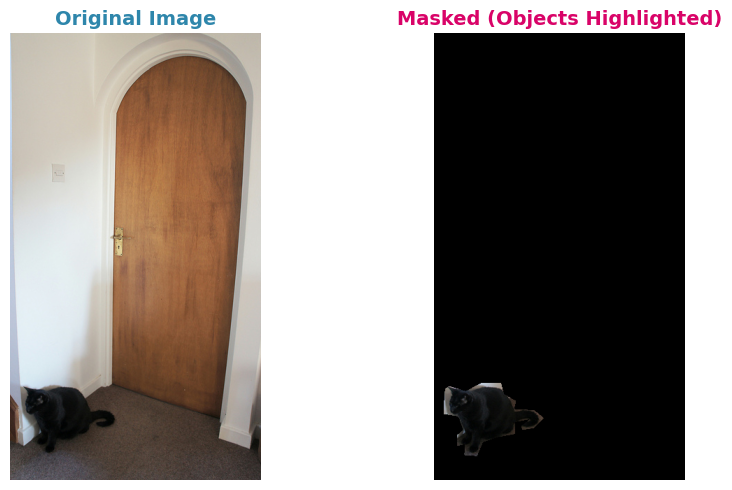

✅ Visualized 1/50


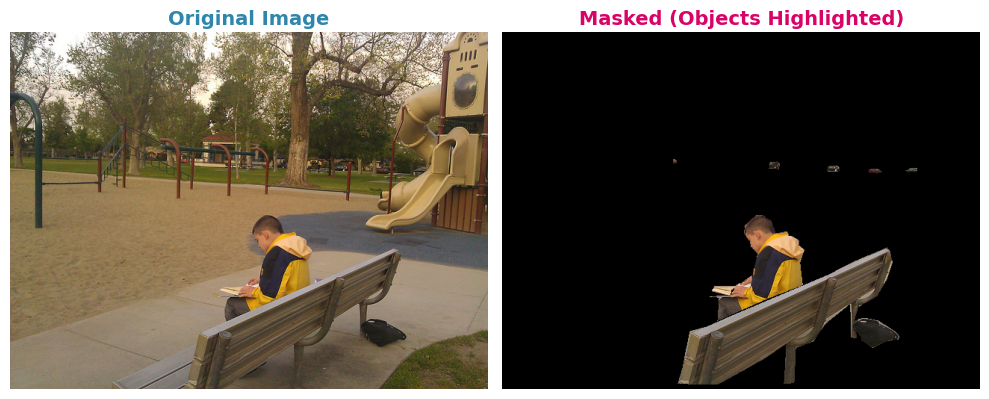

✅ Visualized 2/50


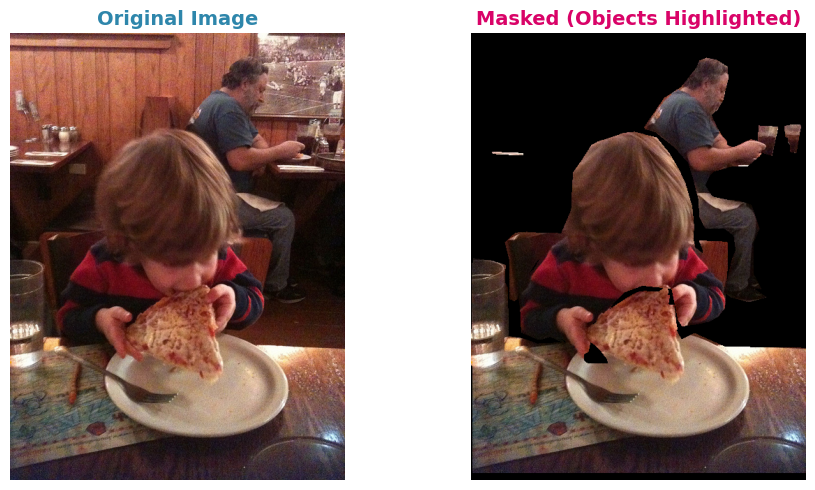

✅ Visualized 3/50


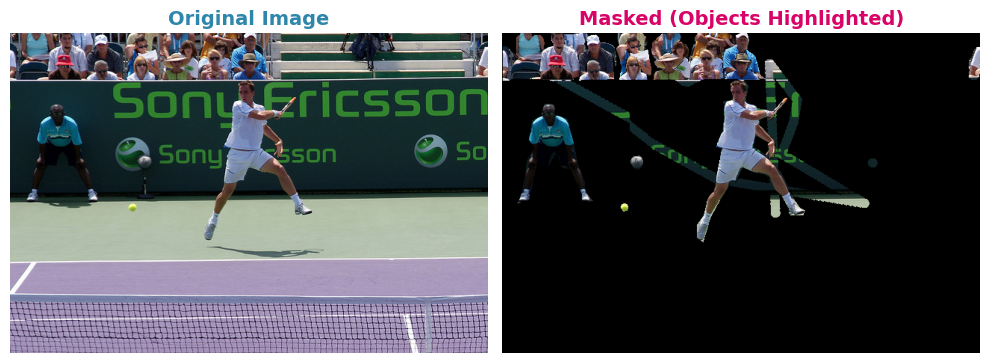

✅ Visualized 4/50


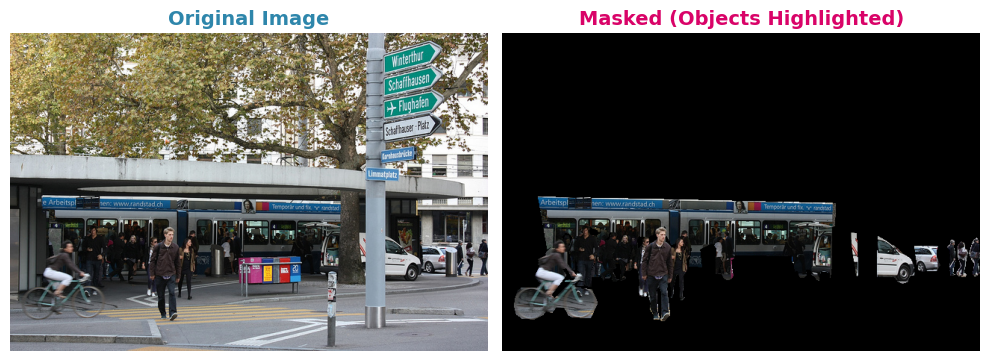

✅ Visualized 5/50


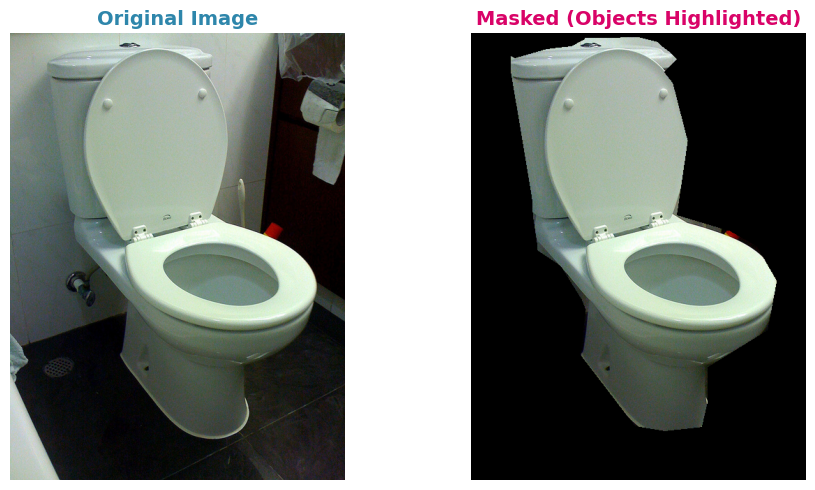

✅ Visualized 6/50


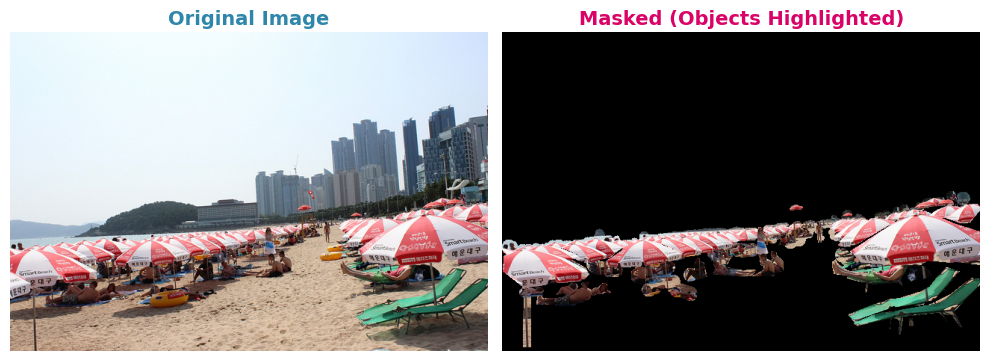

✅ Visualized 7/50


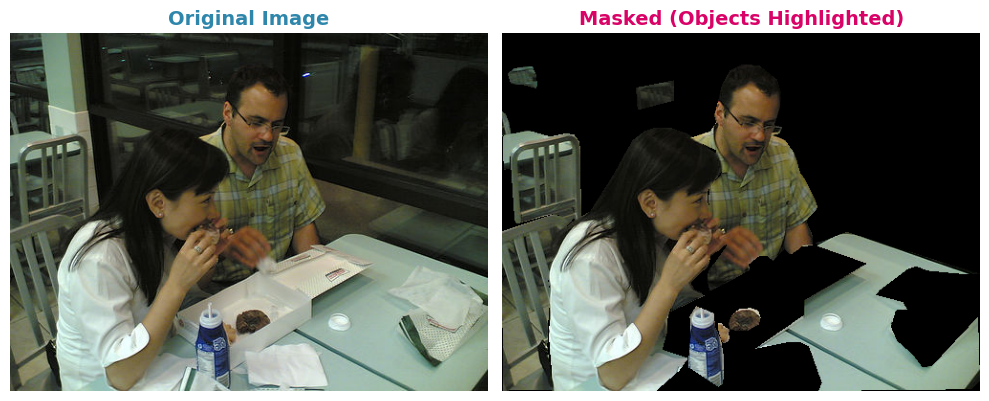

✅ Visualized 8/50


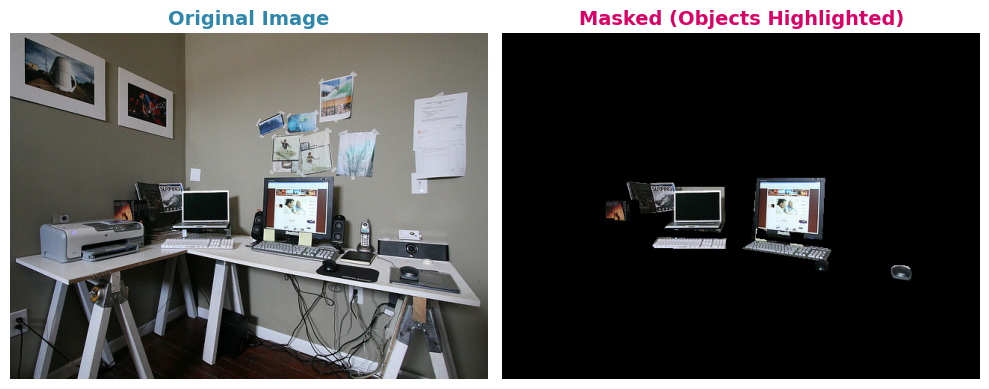

✅ Visualized 9/50


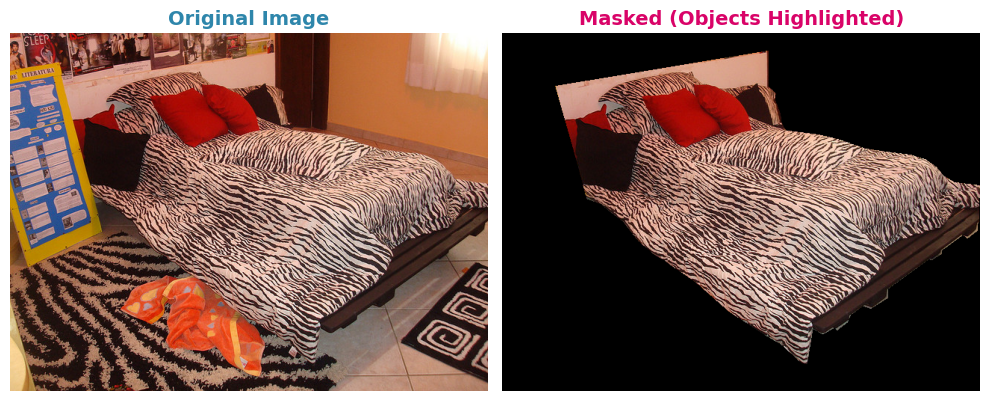

✅ Visualized 10/50


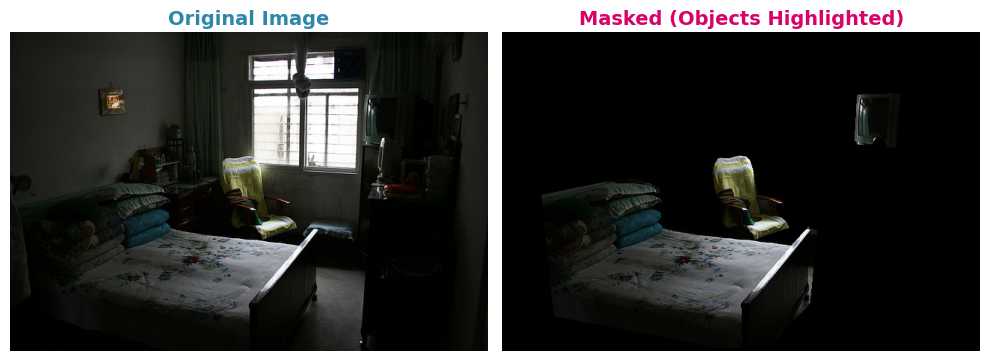

✅ Visualized 11/50


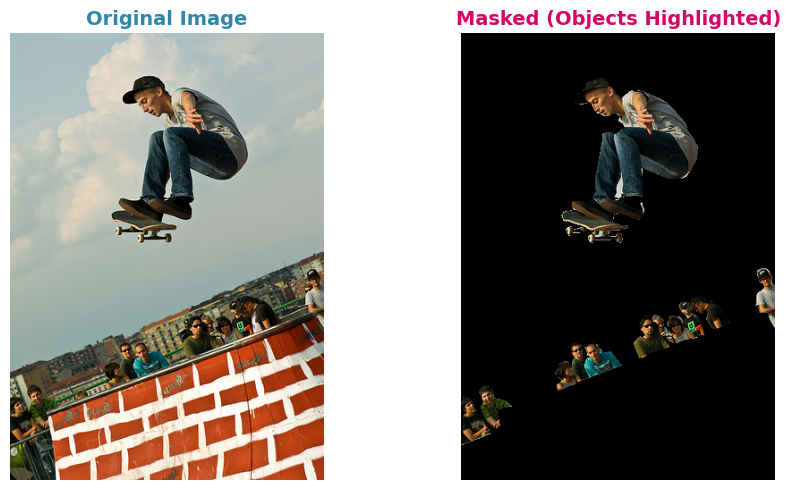

✅ Visualized 12/50


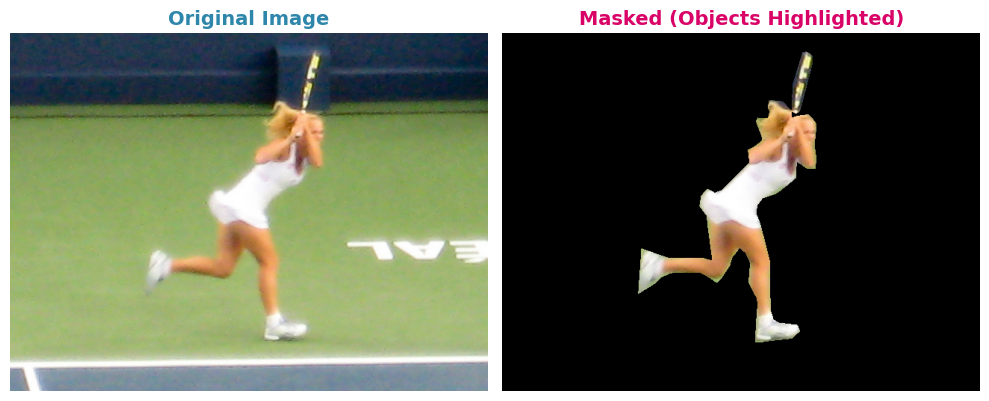

✅ Visualized 13/50


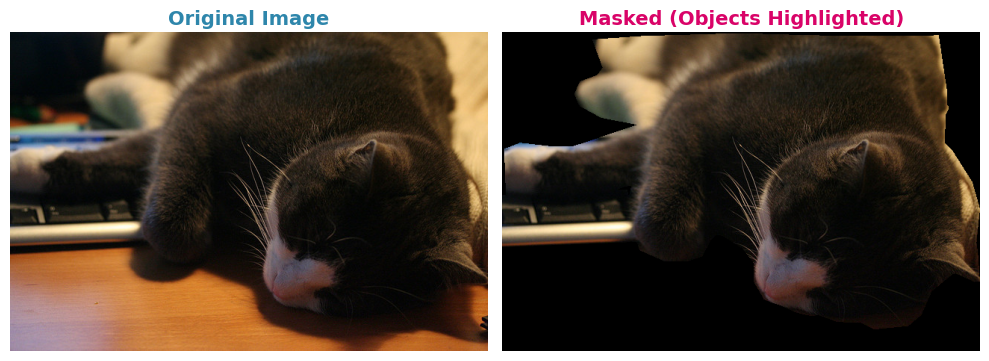

✅ Visualized 14/50


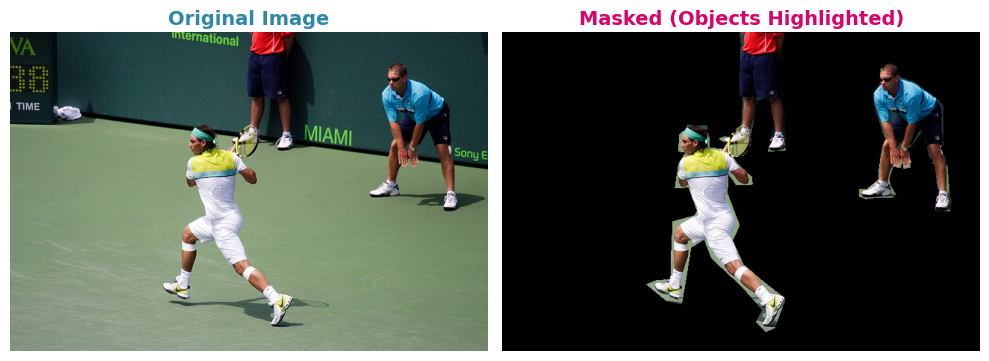

✅ Visualized 15/50


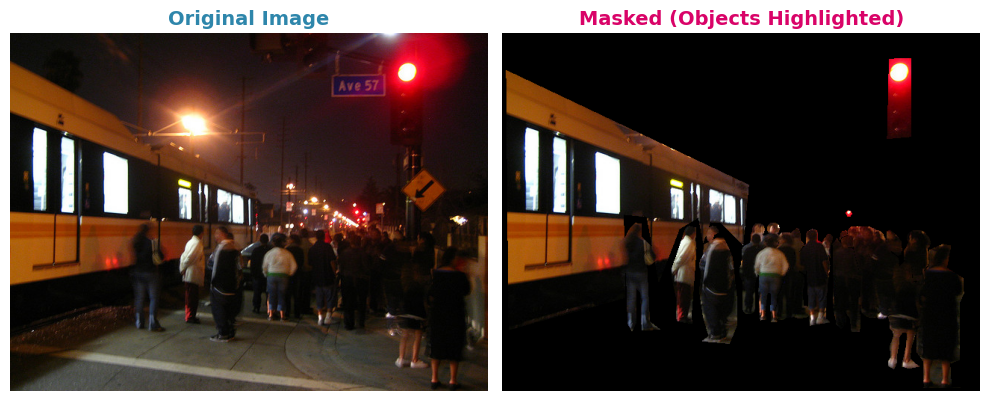

✅ Visualized 16/50


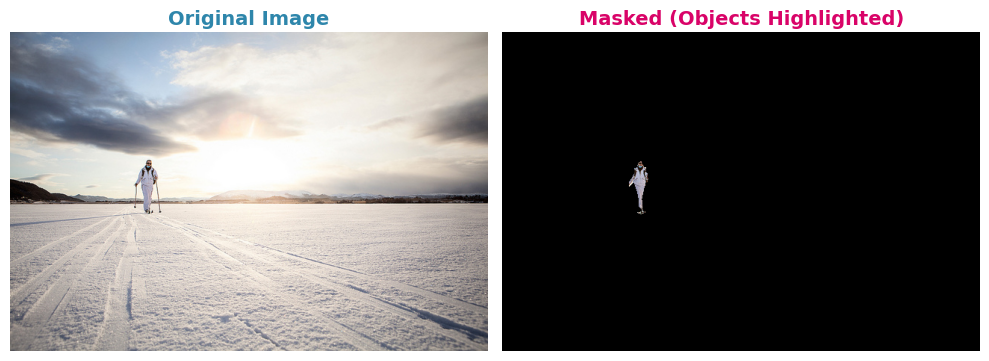

✅ Visualized 17/50


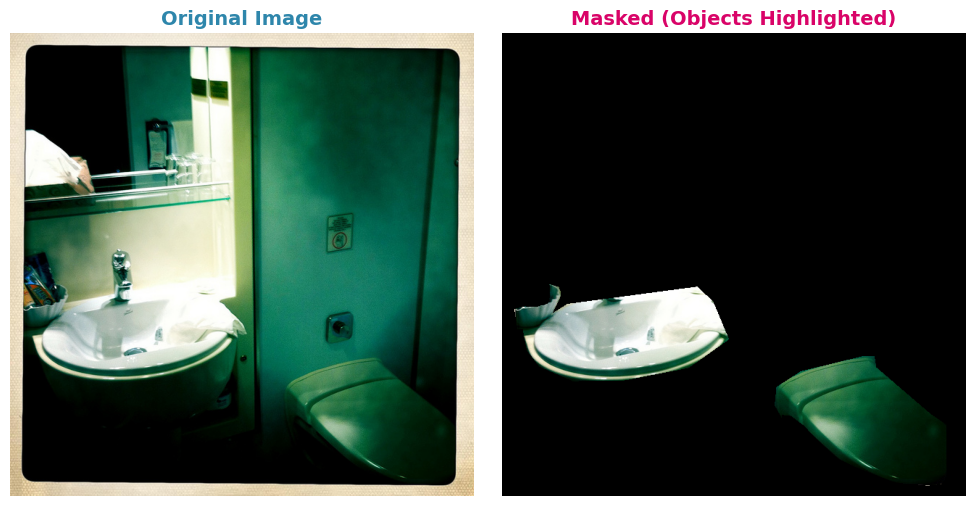

✅ Visualized 18/50


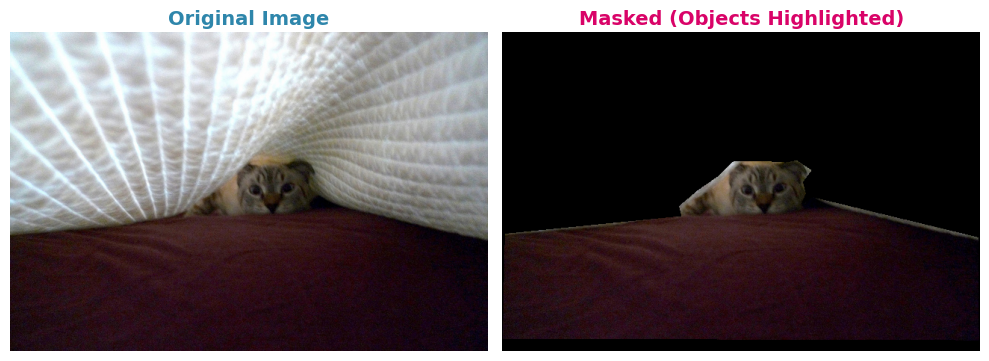

✅ Visualized 19/50


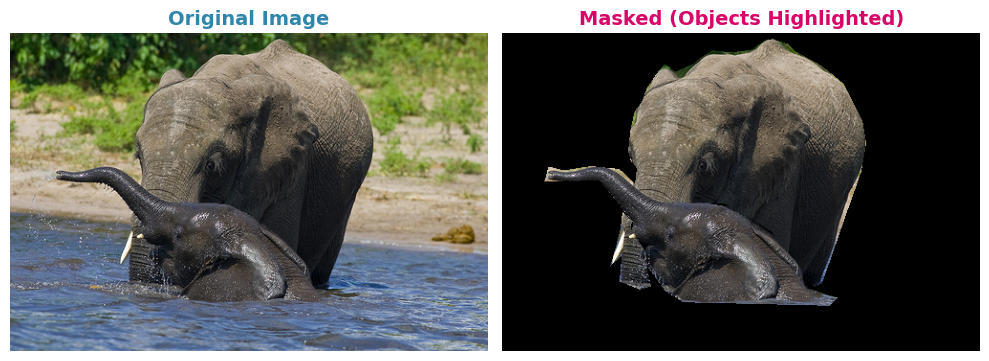

✅ Visualized 20/50


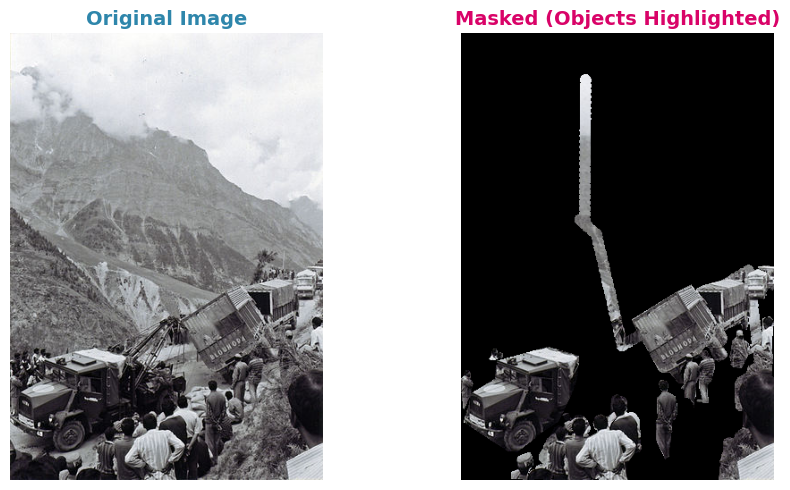

✅ Visualized 21/50


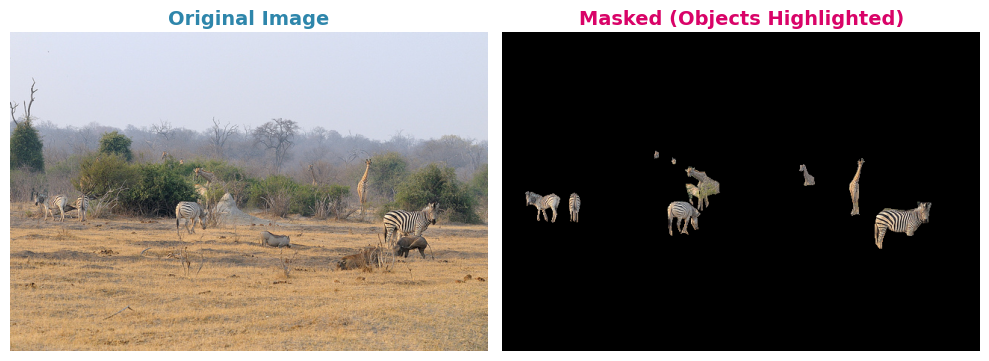

✅ Visualized 22/50


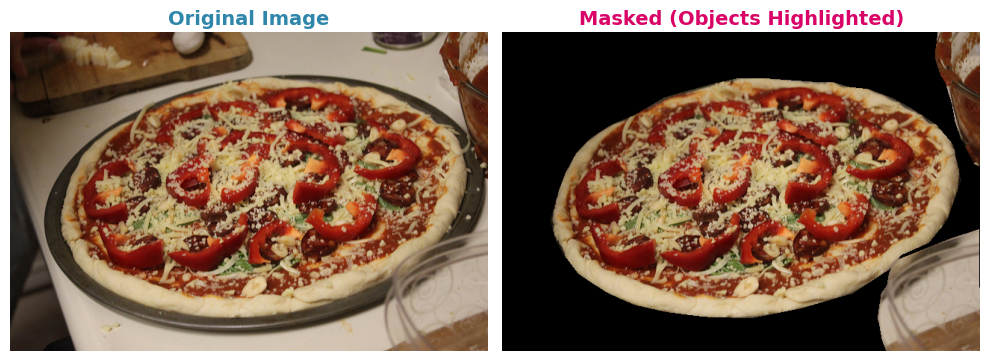

✅ Visualized 23/50


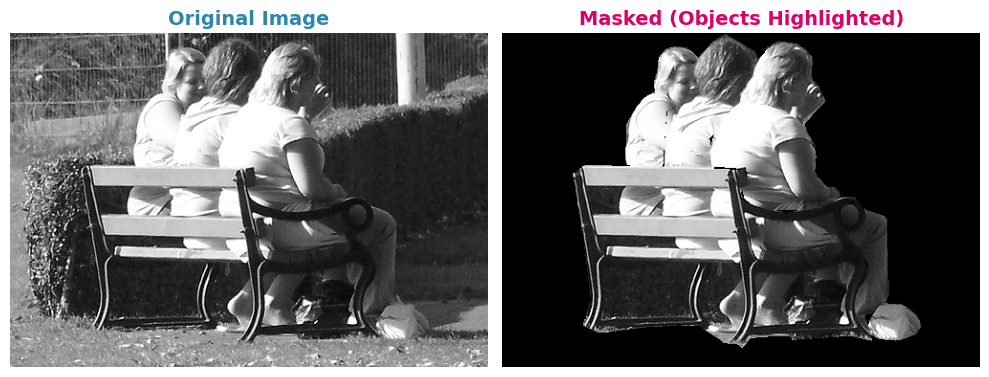

✅ Visualized 24/50


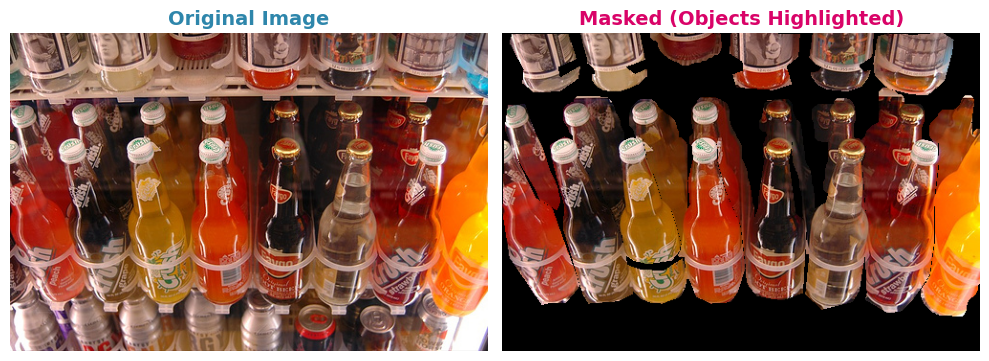

✅ Visualized 25/50


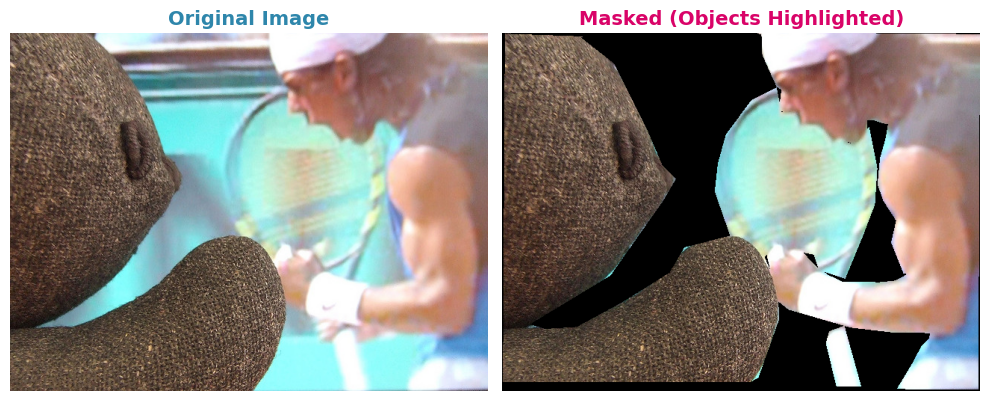

✅ Visualized 26/50


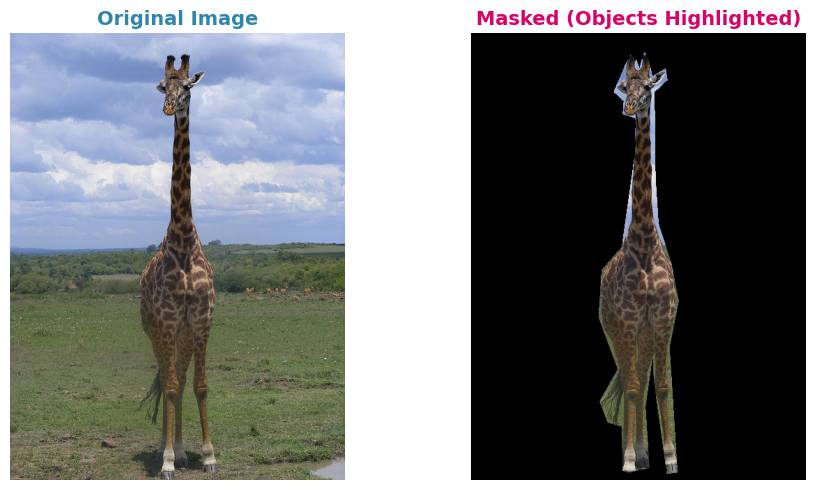

✅ Visualized 27/50


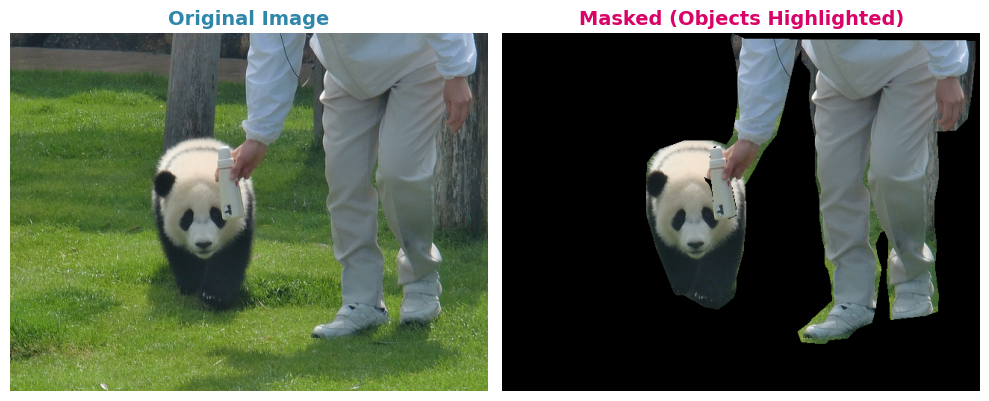

✅ Visualized 28/50


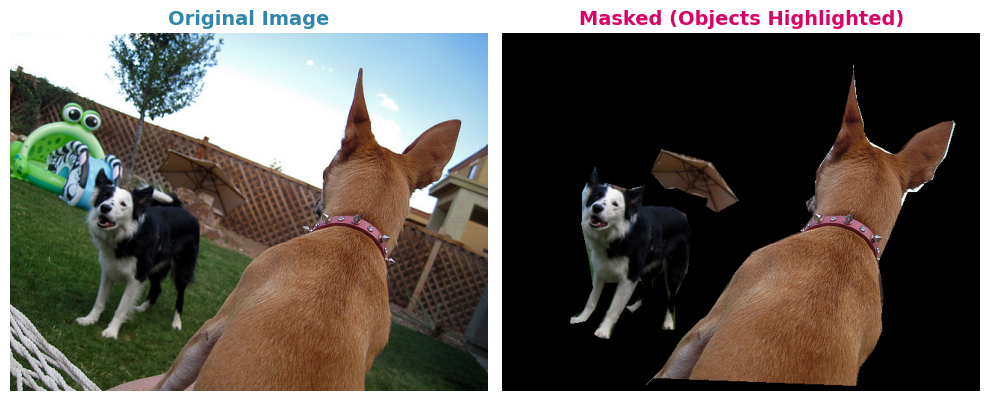

✅ Visualized 29/50


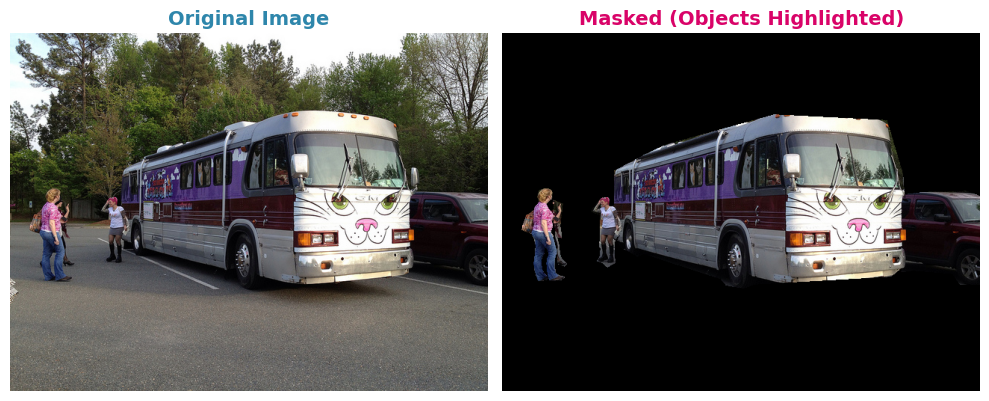

✅ Visualized 30/50


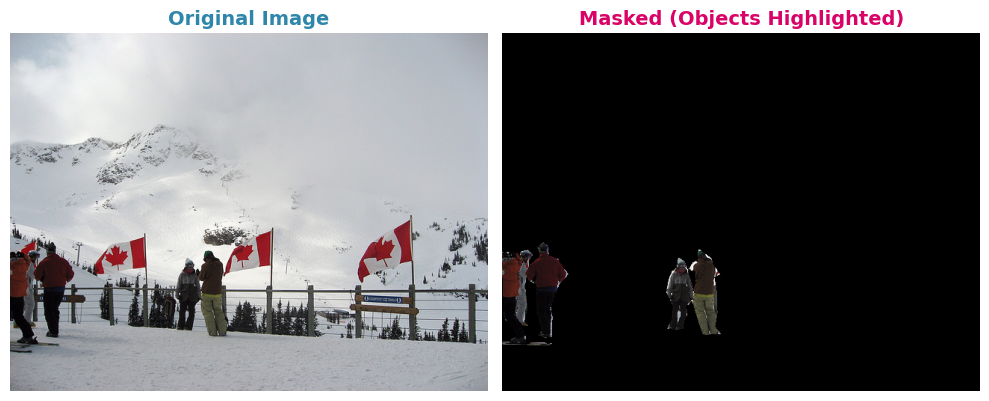

✅ Visualized 31/50


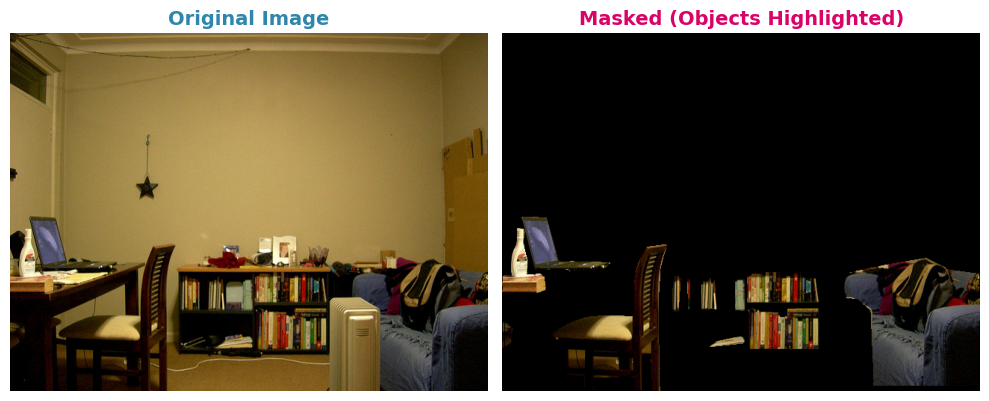

✅ Visualized 32/50


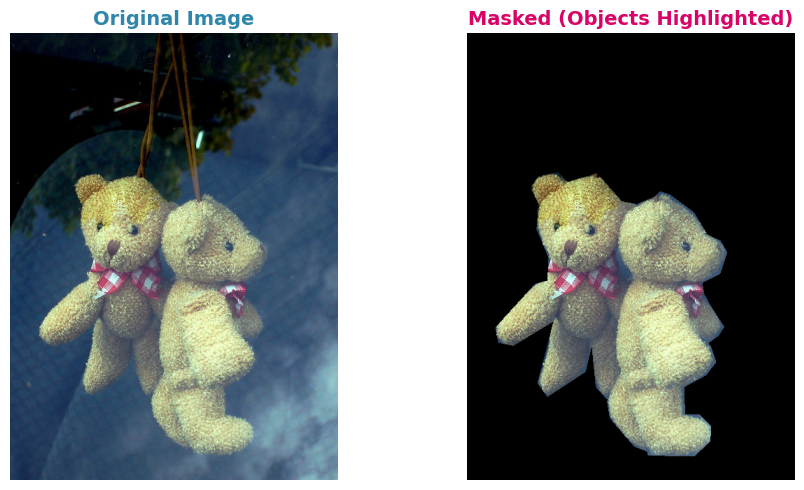

✅ Visualized 33/50


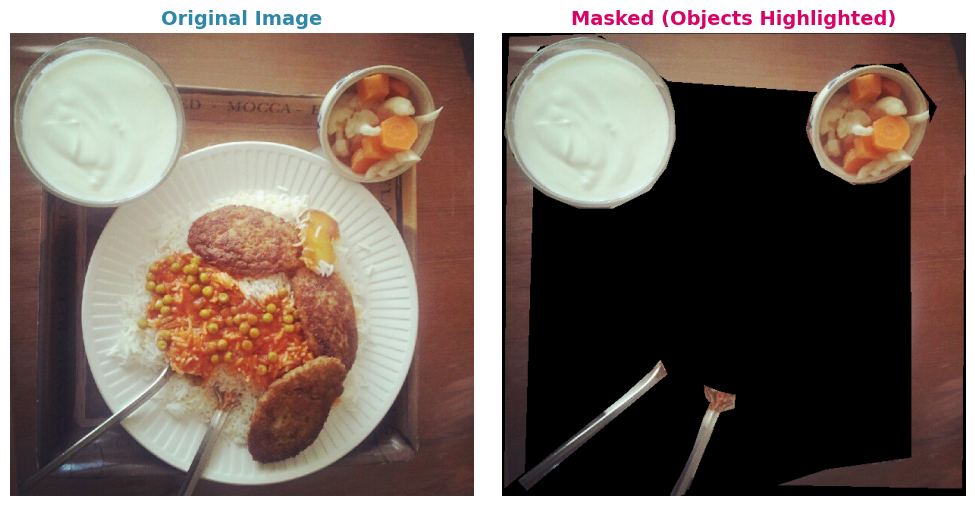

✅ Visualized 34/50


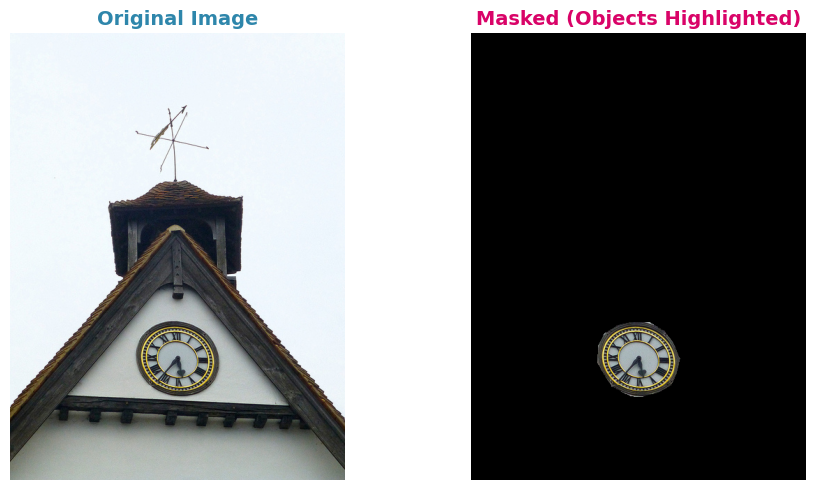

✅ Visualized 35/50


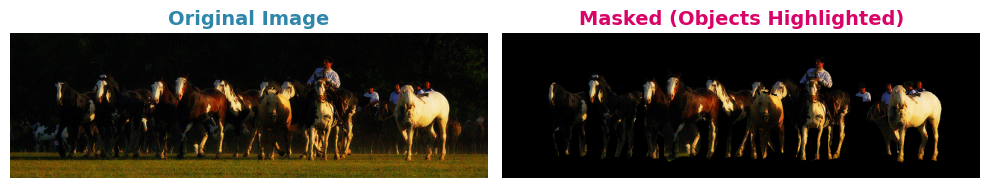

✅ Visualized 36/50


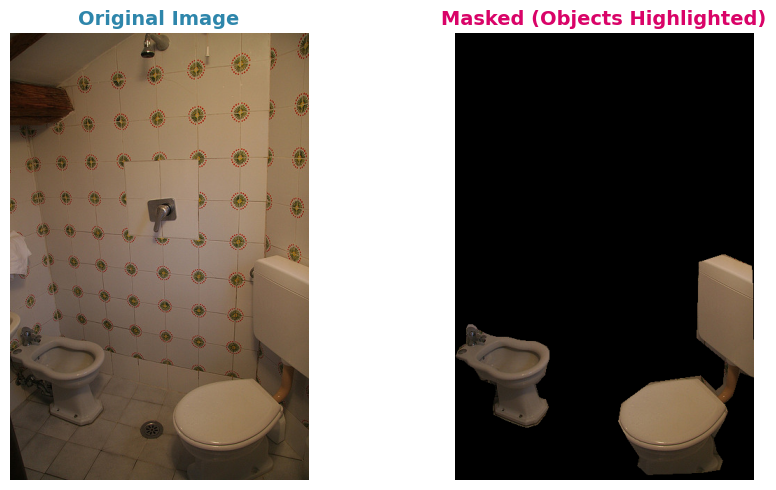

✅ Visualized 37/50


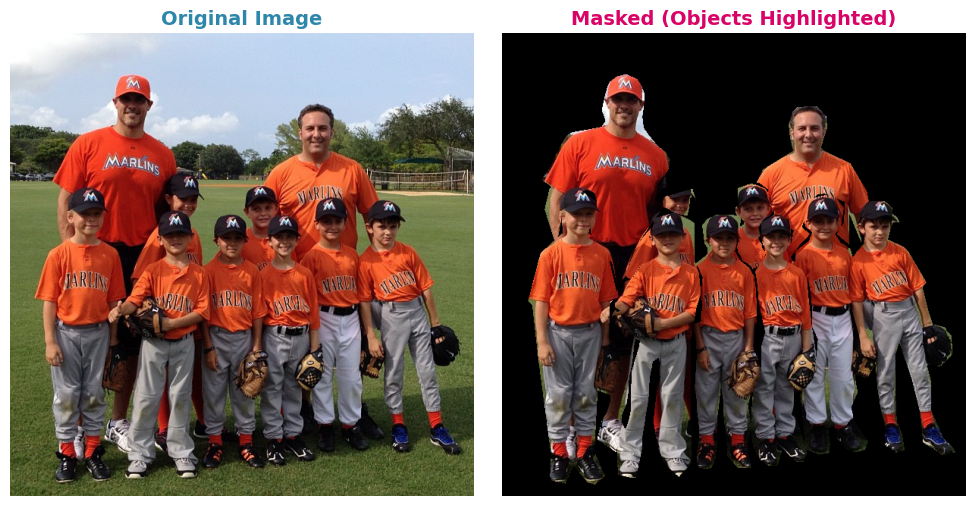

✅ Visualized 38/50


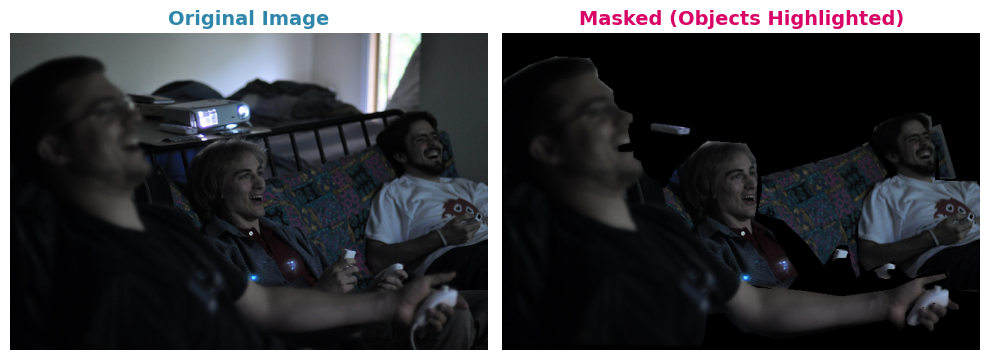

✅ Visualized 39/50


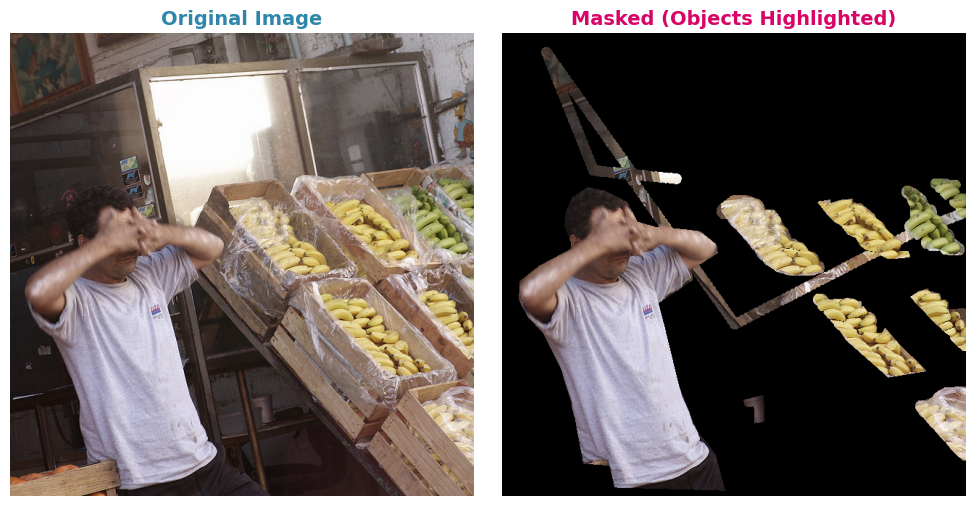

✅ Visualized 40/50


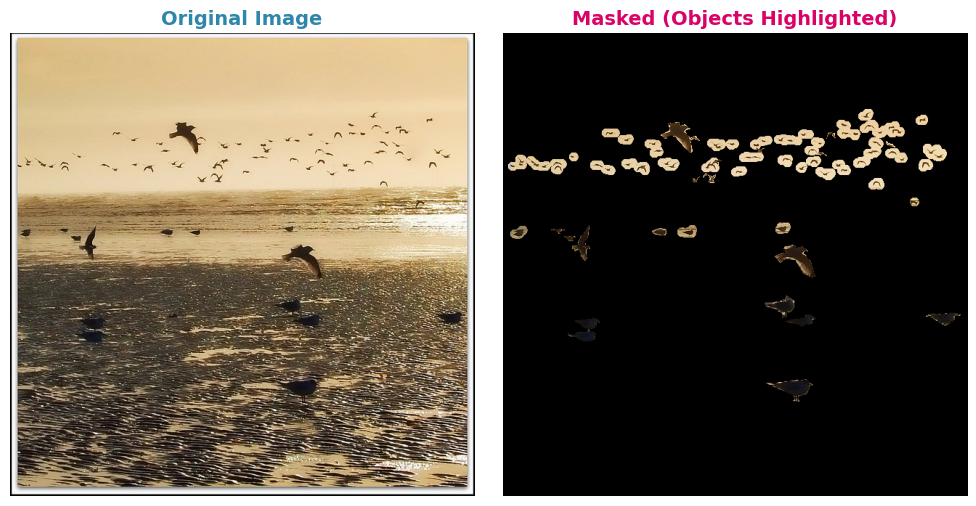

✅ Visualized 41/50


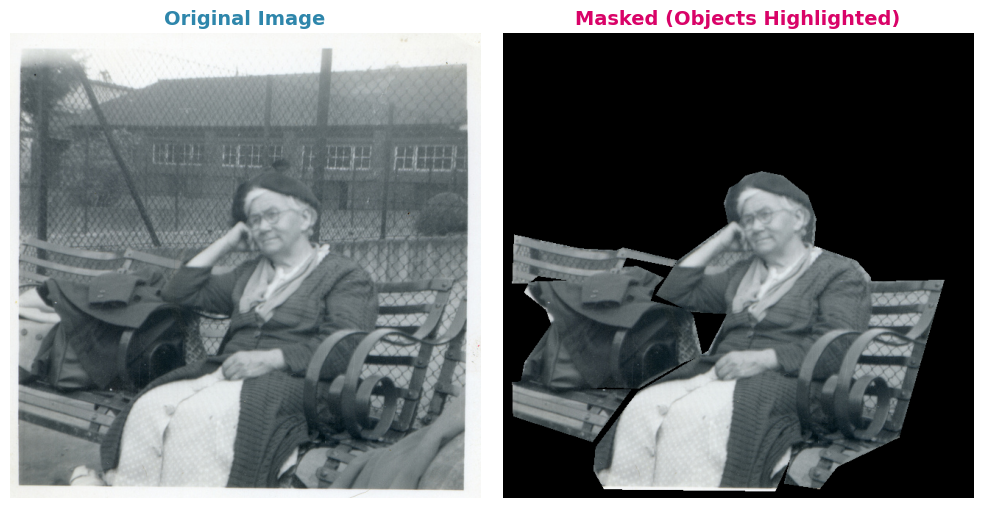

✅ Visualized 42/50


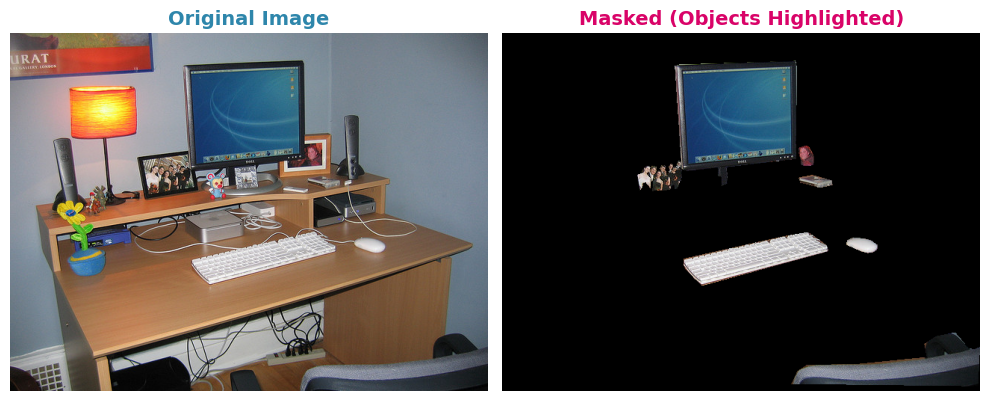

✅ Visualized 43/50


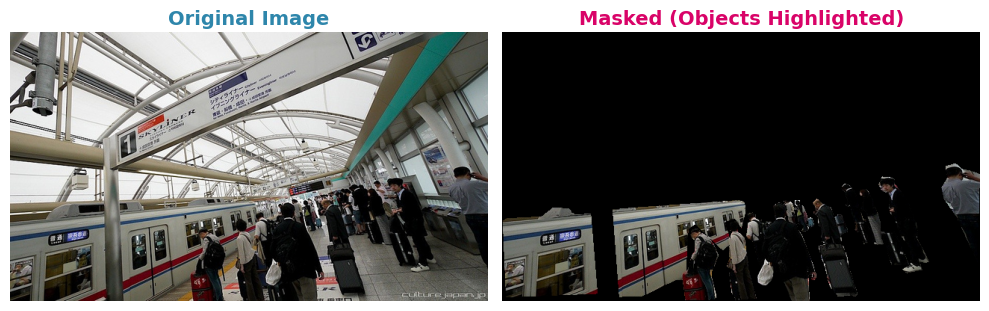

✅ Visualized 44/50


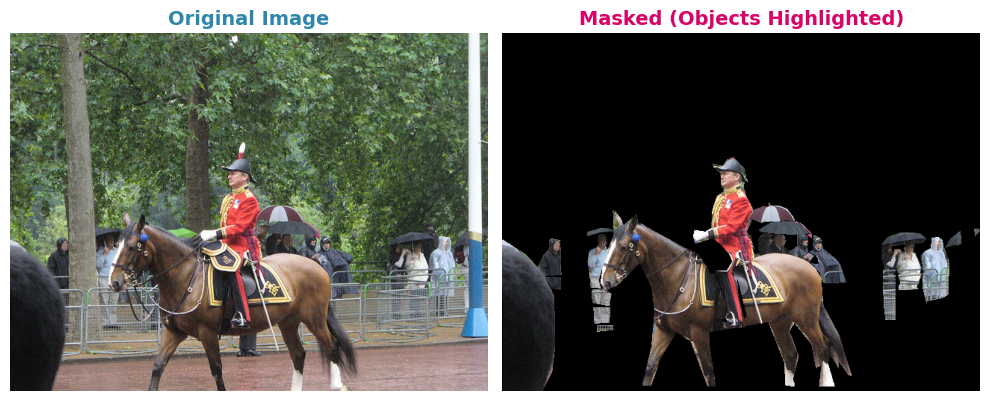

✅ Visualized 45/50


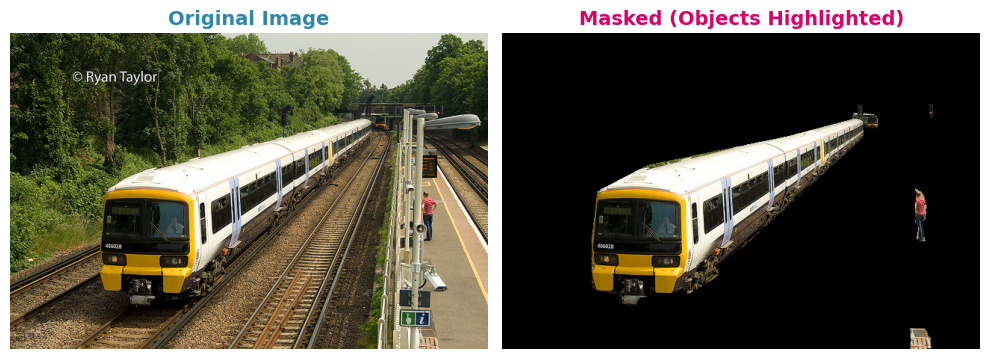

✅ Visualized 46/50


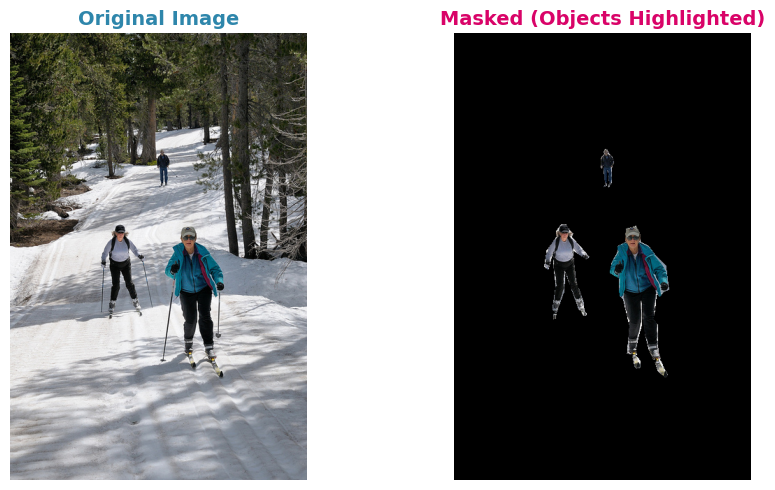

✅ Visualized 47/50


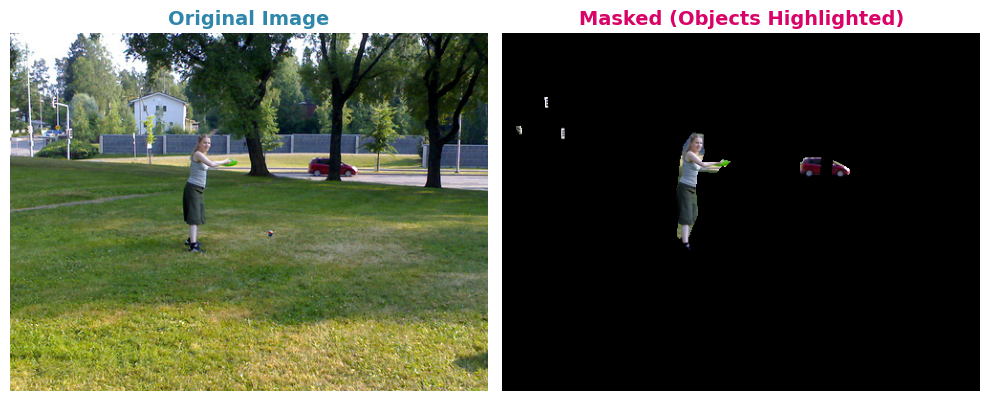

✅ Visualized 48/50


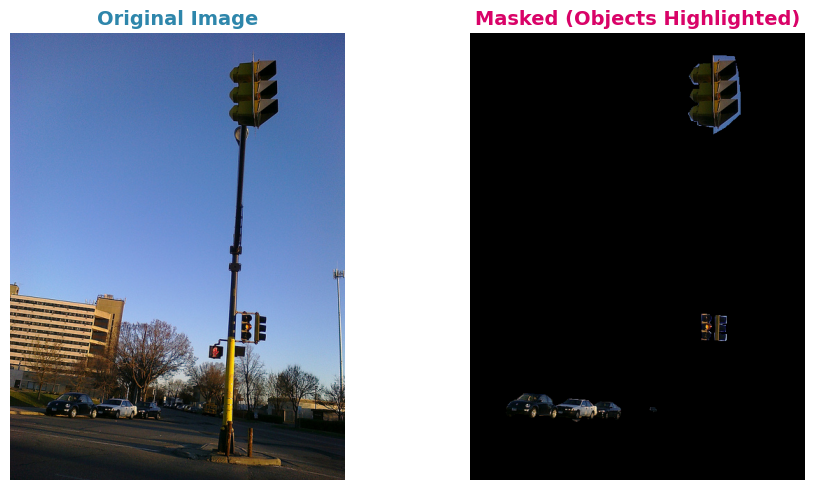

✅ Visualized 49/50


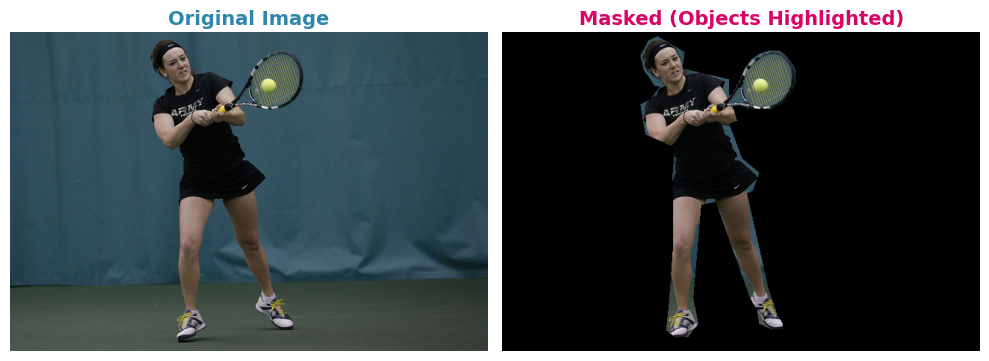

✅ Visualized 50/50

🎯 MILESTONE 1 (WEEK 1) COMPLETED!
✅ Total images visualized: 50
✅ Dataset ready for training!

DATASET STATISTICS

📊 Total images: 5000
📊 Total annotations: 36781
📊 Total categories: 80

🏷️ Sample categories:
    1. person
    2. bicycle
    3. car
    4. motorcycle
    5. airplane
    6. bus
    7. train
    8. truck
    9. boat
   10. traffic light
   11. fire hydrant
   12. stop sign
   13. parking meter
   14. bench
   15. bird

SAVING SAMPLE VISUALIZATIONS
✅ Saved 10 visualizations to 'visualizations/' folder

✅ ✅ ✅ ALL TASKS COMPLETED! ✅ ✅ ✅


In [1]:
# ============================================================================
# IMAGE SEGMENTATION - COCO DATASET VISUALIZATION (JUPYTER NOTEBOOK - FIXED)
# ============================================================================

# STEP 1: Install required packages
!pip install pycocotools matplotlib pillow tqdm wget --quiet

# STEP 2: Import libraries
import os
import zipfile
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from pycocotools.coco import COCO
from tqdm import tqdm
import urllib.request

print("✅ Libraries imported successfully!")

# ============================================================================
# STEP 3: Download COCO 2017 Dataset
# ============================================================================

print("\n" + "="*70)
print("DOWNLOADING COCO 2017 DATASET")
print("="*70)

# Create directories
os.makedirs("annotations", exist_ok=True)
os.makedirs("val2017", exist_ok=True)

# Download annotations (336 MB)
print("\n📥 Step 1: Downloading annotations...")
if not os.path.exists("annotations_trainval2017.zip"):
    urllib.request.urlretrieve(
        "http://images.cocodataset.org/annotations/annotations_trainval2017.zip",
        "annotations_trainval2017.zip"
    )
    print("✅ Annotations downloaded")
else:
    print("✅ Annotations already exist")

print("📦 Extracting annotations...")
with zipfile.ZipFile("annotations_trainval2017.zip", 'r') as zip_ref:
    zip_ref.extractall("annotations")
print("✅ Annotations extracted")

# Download validation images (1 GB - 5,000 images)
print("\n📥 Step 2: Downloading validation images (1 GB)...")
if not os.path.exists("val2017.zip"):
    print("⏳ This may take 5-10 minutes...")
    urllib.request.urlretrieve(
        "http://images.cocodataset.org/zips/val2017.zip",
        "val2017.zip"
    )
    print("✅ Validation images downloaded")
else:
    print("✅ Validation images already exist")

print("📦 Extracting validation images...")
with zipfile.ZipFile("val2017.zip", 'r') as zip_ref:
    zip_ref.extractall(".")
print("✅ Validation images extracted")

# Optional: Download training images subset
print("\n📥 Step 3: Downloading training images subset (OPTIONAL - can skip)")
download_train = input("Download training images? (y/n): ").lower().strip()

if download_train == 'y':
    if not os.path.exists("train2017.zip"):
        print("📥 Downloading train2017.zip (18 GB)...")
        print("⚠️ WARNING: This is a large file and will take 30-60 minutes!")
        urllib.request.urlretrieve(
            "http://images.cocodataset.org/zips/train2017.zip",
            "train2017.zip"
        )
        print("✅ Training images downloaded")
    else:
        print("✅ Training images already exist")

    print("📦 Extracting training subset (first 5,000 images)...")
    os.makedirs("train2017", exist_ok=True)
    
    with zipfile.ZipFile('train2017.zip', 'r') as zip_ref:
        file_list = zip_ref.namelist()
        # Extract only first 5,000 images
        train_files = [f for f in file_list if f.startswith('train2017/') and f.endswith('.jpg')]
        train_files = sorted(train_files)[:5000]
        
        for file in tqdm(train_files, desc="Extracting"):
            zip_ref.extract(file)
    
    print("✅ Training subset extracted")
else:
    print("⏭️ Skipping training images (not needed for visualization)")

print("\n✅ Dataset download complete!")

# ============================================================================
# STEP 4: Load COCO Annotations
# ============================================================================

print("\n" + "="*70)
print("LOADING COCO ANNOTATIONS")
print("="*70)

ANNOTATION_FILE = "annotations/instances_val2017.json"
IMAGE_DIR = "val2017"

print("\n🔹 Loading annotations...")
coco = COCO(ANNOTATION_FILE)
print("✅ Annotations loaded!")

# ============================================================================
# STEP 5: Visualize 50 Image-Mask Pairs
# ============================================================================

print("\n" + "="*70)
print("VISUALIZING IMAGE-MASK PAIRS")
print("="*70)

def visualize_images(coco, img_dir, num_samples=50):
    """
    Visualize original images alongside their masked versions
    """
    img_ids = coco.getImgIds()
    random.shuffle(img_ids)
    shown = 0

    for img_id in img_ids:
        if shown >= num_samples:
            break

        # Load image info
        img_info = coco.loadImgs(img_id)[0]
        img_path = os.path.join(img_dir, img_info['file_name'])
        
        if not os.path.exists(img_path):
            continue

        # Load annotations
        ann_ids = coco.getAnnIds(imgIds=img_info['id'])
        anns = coco.loadAnns(ann_ids)
        
        if not anns:
            continue

        # Load original image
        img = np.array(Image.open(img_path).convert("RGB"))

        # Build combined binary mask (all objects)
        mask = np.zeros((img.shape[0], img.shape[1]), dtype=np.uint8)
        for ann in anns:
            obj_mask = coco.annToMask(ann)
            mask = np.maximum(mask, obj_mask)

        # Create masked image (keep only objects, blacken background)
        masked_img = img.copy()
        masked_img[mask == 0] = 0

        # Display side by side
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        
        ax[0].imshow(img)
        ax[0].set_title("Original Image", fontsize=14, fontweight='bold', color='#2E86AB')
        ax[0].axis("off")

        ax[1].imshow(masked_img)
        ax[1].set_title("Masked (Objects Highlighted)", fontsize=14, fontweight='bold', color='#D90368')
        ax[1].axis("off")

        plt.tight_layout()
        plt.show()

        shown += 1
        print(f"✅ Visualized {shown}/{num_samples}")

    return shown

# Visualize
NUM_SAMPLES = 50
total_visualized = visualize_images(coco, IMAGE_DIR, NUM_SAMPLES)

print("\n" + "="*70)
print("🎯 MILESTONE 1 (WEEK 1) COMPLETED!")
print("="*70)
print(f"✅ Total images visualized: {total_visualized}")
print("✅ Dataset ready for training!")

# ============================================================================
# BONUS: Display Dataset Statistics
# ============================================================================

print("\n" + "="*70)
print("DATASET STATISTICS")
print("="*70)

# Get category information
cats = coco.loadCats(coco.getCatIds())
cat_names = [cat['name'] for cat in cats]

print(f"\n📊 Total images: {len(coco.getImgIds())}")
print(f"📊 Total annotations: {len(coco.getAnnIds())}")
print(f"📊 Total categories: {len(cats)}")
print(f"\n🏷️ Sample categories:")
for i, name in enumerate(cat_names[:15], 1):
    print(f"   {i:2d}. {name}")

# ============================================================================
# OPTIONAL: Save Sample Visualizations to File
# ============================================================================

print("\n" + "="*70)
print("SAVING SAMPLE VISUALIZATIONS")
print("="*70)

os.makedirs("visualizations", exist_ok=True)

def save_visualizations(coco, img_dir, num_samples=10):
    """Save sample visualizations to disk"""
    img_ids = coco.getImgIds()
    random.shuffle(img_ids)
    saved = 0

    for img_id in img_ids:
        if saved >= num_samples:
            break

        img_info = coco.loadImgs(img_id)[0]
        img_path = os.path.join(img_dir, img_info['file_name'])
        
        if not os.path.exists(img_path):
            continue

        ann_ids = coco.getAnnIds(imgIds=img_info['id'])
        anns = coco.loadAnns(ann_ids)
        
        if not anns:
            continue

        img = np.array(Image.open(img_path).convert("RGB"))
        mask = np.zeros((img.shape[0], img.shape[1]), dtype=np.uint8)
        
        for ann in anns:
            mask = np.maximum(mask, coco.annToMask(ann))

        masked_img = img.copy()
        masked_img[mask == 0] = 0

        # Save figure
        fig, ax = plt.subplots(1, 2, figsize=(12, 6))
        
        ax[0].imshow(img)
        ax[0].set_title("Original", fontsize=14, fontweight='bold')
        ax[0].axis("off")

        ax[1].imshow(masked_img)
        ax[1].set_title("Segmented", fontsize=14, fontweight='bold')
        ax[1].axis("off")

        plt.suptitle(f"Sample {saved+1}", fontsize=16, fontweight='bold', y=0.98)
        plt.tight_layout()
        plt.savefig(f"visualizations/sample_{saved+1:02d}.png", dpi=150, bbox_inches='tight')
        plt.close()

        saved += 1

    return saved

saved_count = save_visualizations(coco, IMAGE_DIR, num_samples=10)
print(f"✅ Saved {saved_count} visualizations to 'visualizations/' folder")

print("\n" + "="*70)
print("✅ ✅ ✅ ALL TASKS COMPLETED! ✅ ✅ ✅")
print("="*70)
